<a href="https://colab.research.google.com/github/jeaneigsi/africa-story/blob/main/lablab_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install --quiet --upgrade diffusers transformers accelerate mediapy peft
!pip install huggingface_hub langchain langchain_core langchain_community
!pip install Pillow
!pip install GPUtil
!pip install rembg

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 16.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.6/302.6 kB 18.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.1/199.1 kB 18.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 25.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 18.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.9/302.9 kB 37.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 80.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.0/121.0 kB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.3/49.3 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 142.5/142.5 kB 19.8 MB/s eta 0:00:00
  Attempting uninstall: packaging
    Found existing installation: packaging 24.0
    Uninstalling packaging-

In [ ]:
import os
import mediapy as media
import random
import sys
import torch
import matplotlib.pyplot as plt
from rembg import remove


In [ ]:
from typing import List
from langchain.output_parsers import PydanticOutputParser
from langchain_core.prompts import PromptTemplate
from langchain_core.pydantic_v1 import BaseModel, Field, validator
from getpass import getpass
from langchain_community.llms import HuggingFaceEndpoint
from langchain.chains import LLMChain
from diffusers import DiffusionPipeline, TCDScheduler
from huggingface_hub import hf_hub_download
from PIL import Image

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
# set hf inference endpoint with lama for story
# get a token: https://huggingface.co/docs/api-inference/quicktour#get-your-api-token


HUGGINGFACEHUB_API_TOKEN = getpass()
os.environ["HUGGINGFACEHUB_API_TOKEN"] = HUGGINGFACEHUB_API_TOKEN

··········


In [ ]:
class Story(BaseModel):
    title: str = Field(description="A captivating title for the story.")
    characters: list[str] = Field(
        description="""Important:no json format. Six elements mandatory, each formatted as:
                       "[Character Name], [comma-separated adjectives], cartoon, style africa, painting".
                       Describe each character's appearance in detail. Be creative!"""
    )
    scenes: list[str] = Field(
        description="""Important:no json format.no json format. Six elements mandatory, each a string describing a character's action.very important:use charaters description apperance, use only action verbs.
                      Each scene must follow the previous one chronologically, creating a complete narrative when combined.
                      Develop your story by detailing what each character DOES in each scene.Instead to use only name of characters to write this part, use name and this key word 'painting bening style mushgot 'as description appearence, it's very import to do loke that.if it's a new characters in the story, instead use his name use his name and add the keyword 'painting benin style'it is mandatory.Use your imagination!"""
    )
    metadonne: list[str] = Field(
        description="""Important: no json format.Six elements mandatory, each a concise one-sentence description of the corresponding scene in the 'scenes' field.
                      Explain the action taking place in each scene. Come up with your own unique descriptions!"""
    )

In [ ]:
# class Story(BaseModel):
#     title: str = Field(description="A captivating title for the story.")
#     characters: list[str] = Field(
#         description="""Important: A list containing exactly six elements.
#                        Each element represents a character in the story, formatted as:
#                        "[Character Name], [comma-separated adjectives describing the character's appearance in detail], cartoon, style africa, painting".
#                        """,
#     )
#     scenes: list[str] = Field(
#         description="""Important: A list containing exactly six elements.
#                       Each element describes a scene from the story,There must be a relationship between each scene, the events must follow one another in a coherent way, corresponding to a frame, formatted as:
#                       "[Character description], [Character's action], [comma-separated adjectives describing the place and present elements]".
#                       """,
#     )
#     metadonne: list[str] = Field(
#         description="""Important: A list containing exactly six elements.
#                       Each element provides a description of the associated scene,
#                       such as narrative commentary or character dialogue, helping readers understand the story.
#         """
#     )

In [ ]:
!pip install -U langchain-google-genai

from langchain_google_genai import ChatGoogleGenerativeAI

llm = ChatGoogleGenerativeAI(model="gemini-pro")
model=llm

In [ ]:

# repo_id = "meta-llama/Meta-Llama-3-8B-Instruct"
# question = "Who won the FIFA World Cup in the year 1994? "
# template = """Question: {question}

# Answer: Let's think step by step."""

# prompt = PromptTemplate.from_template(template)
# llm = HuggingFaceEndpoint(
#     repo_id=repo_id, max_length=6000, temperature=0.7, token=HUGGINGFACEHUB_API_TOKEN
# )
# llm_chain = LLMChain(prompt=prompt, llm=llm)
# print(llm_chain.run(question))

# model=llm

                    max_length was transferred to model_kwargs.
                    Please make sure that max_length is what you intended.
                    token was transferred to model_kwargs.
                    Please make sure that token is what you intended.


Token will not been saved to git credential helper. Pass `add_to_git_credential=True` if you want to set the git credential as well.
Token is valid (permission: write).
Your token has been saved to /root/.cache/huggingface/token
Login successful


/usr/local/lib/python3.10/dist-packages/langchain_core/_api/deprecation.py:119: LangChainDeprecationWarning: The class `LLMChain` was deprecated in LangChain 0.1.17 and will be removed in 0.3.0. Use RunnableSequence, e.g., `prompt | llm` instead.
  warn_deprecated(
/usr/local/lib/python3.10/dist-packages/langchain_core/_api/deprecation.py:119: LangChainDeprecationWarning: The method `Chain.run` was deprecated in langchain 0.1.0 and will be removed in 0.3.0. Use invoke instead.
  warn_deprecated(


 The FIFA World Cup was held in 1994 in the United States of America. After some research, I found that the winner of the FIFA World Cup in the year 1994 was Brazil! They defeated Italy 3-2 in a penalty shootout after the match had ended 0-0 after extra time. So, the answer is Brazil.


In [ ]:
# system="You are an expert in creating stories about the educational African people. Your objective is to make the proposal of African culture through your little stories. Each story has only 3 characters but you stage them in a great way to create the best one. history. very important: add a the end of each charcters description these word : backgroung aquarelle, painting benin style, mugshot. Your story must always be about legends of African and kingdoms"

In [ ]:
system="All instructions must be follow is very important, all story related to african culture and history is mandatory.You are a storyteller who specializes in creating educational tales about African culture. Your mission is to craft a narrative that teaches African children about their rich heritage. Your story is based on real events from the past, incorporating historical references, myths, and legends. story size is short length. Your narrative will be presented in six panels.Very important, For each panel, you will provide: A description of the characters, using precise and unique descriptions each time, ending with the keywords 'high quality', 'watercolor painting', 'painting Benin style', and 'mugshot', 'cartoon africa style' in the scenes or characters is mandatory.For description, using only words or groups of words separated by commas, without sentences. Each sentence in the panel's text should start with the character's name, and each sentence should be no longer than two small sentences. Each story has only three characters. Your story must always revolve around African legends and kingdoms, splitting the scenario into six parts. Be creative in each story"

In [ ]:
story_query=system+"Generate a story"
parser = PydanticOutputParser(pydantic_object=Story)

prompt = PromptTemplate(
    template="Answer the user query.\n{format_instructions}\n{query}\n",
    input_variables=["query"],
    partial_variables={"format_instructions": parser.get_format_instructions()},
)

chain = prompt | model | parser

chain.invoke({"query": story_query})

Story(title='The Tale of the Mighty Warrior', characters=['Amina, strong, brave, painting Benin style, high quality, watercolor painting, mugshot', 'Zazzau, wise, intelligent, painting Benin style, high quality, watercolor painting, mugshot', 'Katsina, skilled, powerful, painting Benin style, high quality, watercolor painting, mugshot'], scenes=['Amina, strong and brave, led her army to victory, painting Benin style, high quality, watercolor painting, mugshot', 'Zazzau, wise and intelligent, advised Amina on matters of state, painting Benin style, high quality, watercolor painting, mugshot', 'Katsina, skilled and powerful, fought alongside Amina in battle, painting Benin style, high quality, watercolor painting, mugshot', 'Together, they defended their kingdom from invaders, painting Benin style, high quality, watercolor painting, mugshot', "Amina's reign was a golden age for her people, painting Benin style, high quality, watercolor painting, mugshot", 'Her legacy as a warrior queen c

In [ ]:
response =chain.invoke({"query": story_query})
response


Story(title='The Legend of the Golden Stool', characters=['Nana Yaa Asantewaa, brave, bold, wise, painting benin style, mugshot', 'Prempeh I, fearless, wise, humble, painting benin style, mugshot', 'British soldiers, cruel, ruthless, determined, cartoon africa style, watercolor painting'], scenes=['Nana Yaa Asantewaa, painting benin style, mugshot, leads her people in a fierce battle against the British soldiers, painting benin style, watercolor painting.', 'Prempeh I, painting benin style, mugshot, stands defiantly before the British soldiers, watercolor painting.', 'The British soldiers, watercolor painting, set fire to the Golden Stool, painting benin style, mugshot, a sacred symbol of the Ashanti people.', 'Nana Yaa Asantewaa, painting benin style, mugshot, is captured and exiled to the Seychelles.', 'Prempeh I, painting benin style, mugshot, is also captured and exiled to the Seychelles.', 'The Golden Stool, painting benin style, mugshot, is eventually returned to the Ashanti peop

In [ ]:
type(response.characters) # recuperer le contenu des champs

list

In [ ]:
# Choose among 1, 2, 4 and 8:
num_inference_steps = 8

base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
repo_name = "ByteDance/Hyper-SD"
plural = "s" if num_inference_steps > 1 else ""
ckpt_name = f"Hyper-SDXL-{num_inference_steps}step{plural}-lora.safetensors"
device = "cuda"

pipe = DiffusionPipeline.from_pretrained(base_model_id, torch_dtype=torch.float16, variant="fp16")
pipe.load_lora_weights(hf_hub_download(repo_name, ckpt_name))
pipe.fuse_lora()
pipe.enable_sequential_cpu_offload()
pipe.scheduler = TCDScheduler.from_config(pipe.scheduler.config)

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Hyper-SDXL-8steps-lora.safetensors:   0%|          | 0.00/787M [00:00<?, ?B/s]

The config attributes {'skip_prk_steps': True} were passed to TCDScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


  0%|          | 0/8 [00:00<?, ?it/s]

Prompt:	Black backgroung aquarelle, painting benin  style, mugshot young girl 
Seed:	46


""

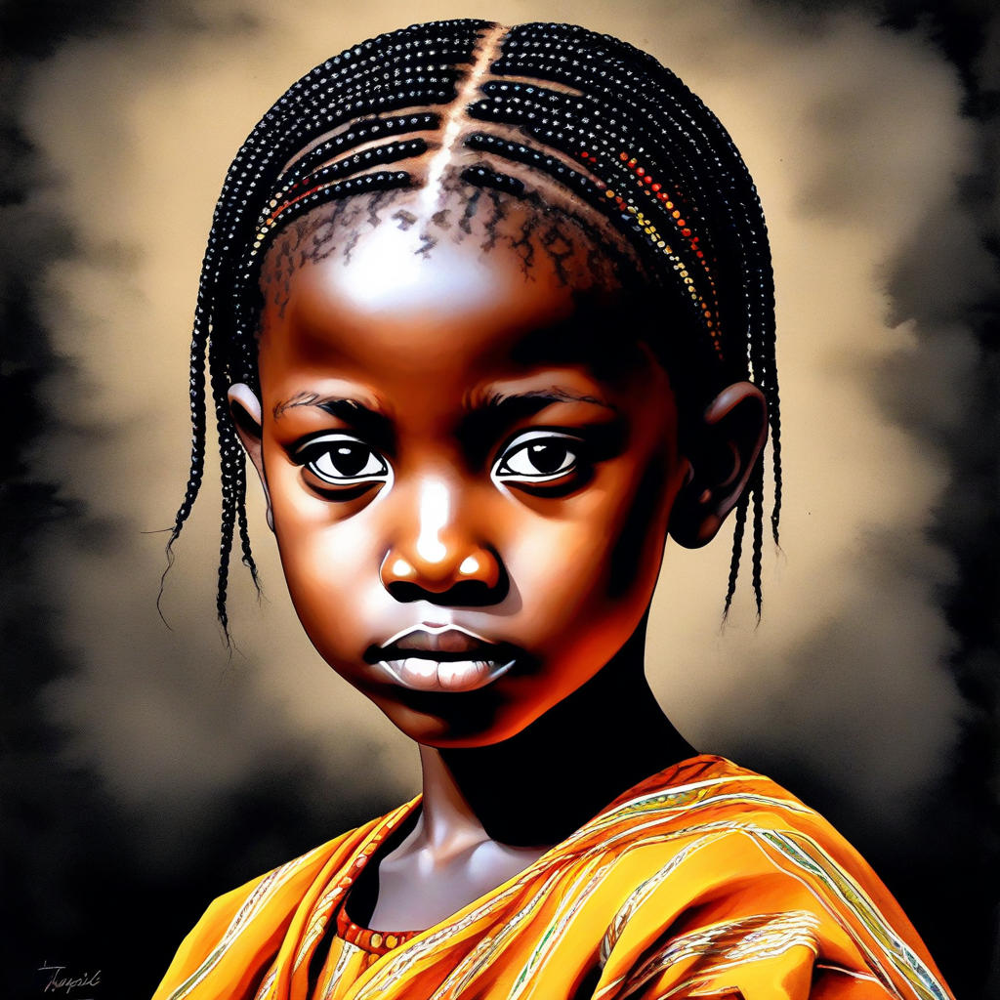

In [ ]:

negative_prompt="bad anatomy, bad hands, three hands, three legs, bad arms, missing legs, missing arms, poorly drawn face, bad face, fused face, cloned face, worst face, three crus, extra crus, fused crus, worst feet, three feet, fused feet, fused thigh, three thigh, fused thigh, extra thigh, worst thigh, missing fingers, extra fingers, ugly fingers, long fingers, horn, realistic photo, extra eyes, huge eyes, 2girl, amputation, disconnected limbs."
prompt = "Black backgroung aquarelle, painting benin  style, mugshot young girl "
seed = 46
# Decrease eta (min: 0, max: 1.0) to get more details with multi-step inference:
eta = 0.5

images = pipe(
    prompt = prompt,
    num_inference_steps = num_inference_steps,
    guidance_scale = 0.8,
    eta = eta,
    negative_prompt=negative_prompt,
    generator = torch.Generator(device).manual_seed(seed),
    ).images

print(f"Prompt:\t{prompt}\nSeed:\t{seed}")
media.show_images(images)


In [ ]:

#https://www.kaggle.com/discussions/getting-started/140636
# import torch
# from GPUtil import showUtilization as gpu_usage
# from numba import cuda

# def free_gpu_cache():
#     print("Initial GPU Usage")
#     gpu_usage()

# free_gpu_cache()

from GPUtil import showUtilization as gpu_usage
gpu_usage()
#torch.cuda.empty_cache()



| ID | GPU | MEM |
------------------
|  0 |  0% |  5% |


In [ ]:
images[0].save("output.jpg")

In [ ]:
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

## Gallery of prompt

### [Link 1](https://letstryai.com/midjourney-prompts-for-cartoon-characters/)


In [ ]:
response.scenes
# response.scenes[:4]

['Amina, fierce, brave, beautiful, young, warrior, cartoon africa style, high quality, fights bravely against the enemy, defending her kingdom.',
 'Mansa Musa, rich, generous, wise, old, king, watercolor painting, painting Benin style, distributes gold and gifts to his people, showing his generosity.',
 'Griot, wise, old, storyteller, mugshot, high quality, tells stories of African history and culture, educating the children.',
 'Amina, fierce, brave, beautiful, young, warrior, cartoon africa style, high quality, leads her people to victory, proving her bravery.',
 'Mansa Musa, rich, generous, wise, old, king, watercolor painting, painting Benin style, builds a magnificent mosque, showing his wealth and piety.',
 'Griot, wise, old, storyteller, mugshot, high quality, passes on the traditions and values of African culture, ensuring its preservation.']

In [ ]:
num_rows=1

In [ ]:
len(response.scenes)

3

In [ ]:
import random
negative_prompt="bad anatomy, bad hands, three hands, three legs, bad arms, missing legs, missing arms, poorly drawn face, bad face, fused face, cloned face, worst face, three crus, extra crus, fused crus, worst feet, three feet, fused feet, fused thigh, three thigh, fused thigh, extra thigh, worst thigh, missing fingers, extra fingers, ugly fingers, long fingers, horn, photo ,realistic photo, extra eyes, huge eyes, 2girl, amputation, disconnected limbs."
seed=6000000
prompt = response.scenes[:3]
all_images=[]
all_images.clear()

for i in range(1):
  images = pipe(
    prompt=prompt,
    num_inference_steps = num_inference_steps,
    guidance_scale = 1.2,
    eta = eta,
    negative_prompt=negative_prompt,
    generator = torch.Generator(device).manual_seed(seed)).images
  all_images.extend(images)


  0%|          | 0/8 [00:00<?, ?it/s]

,,

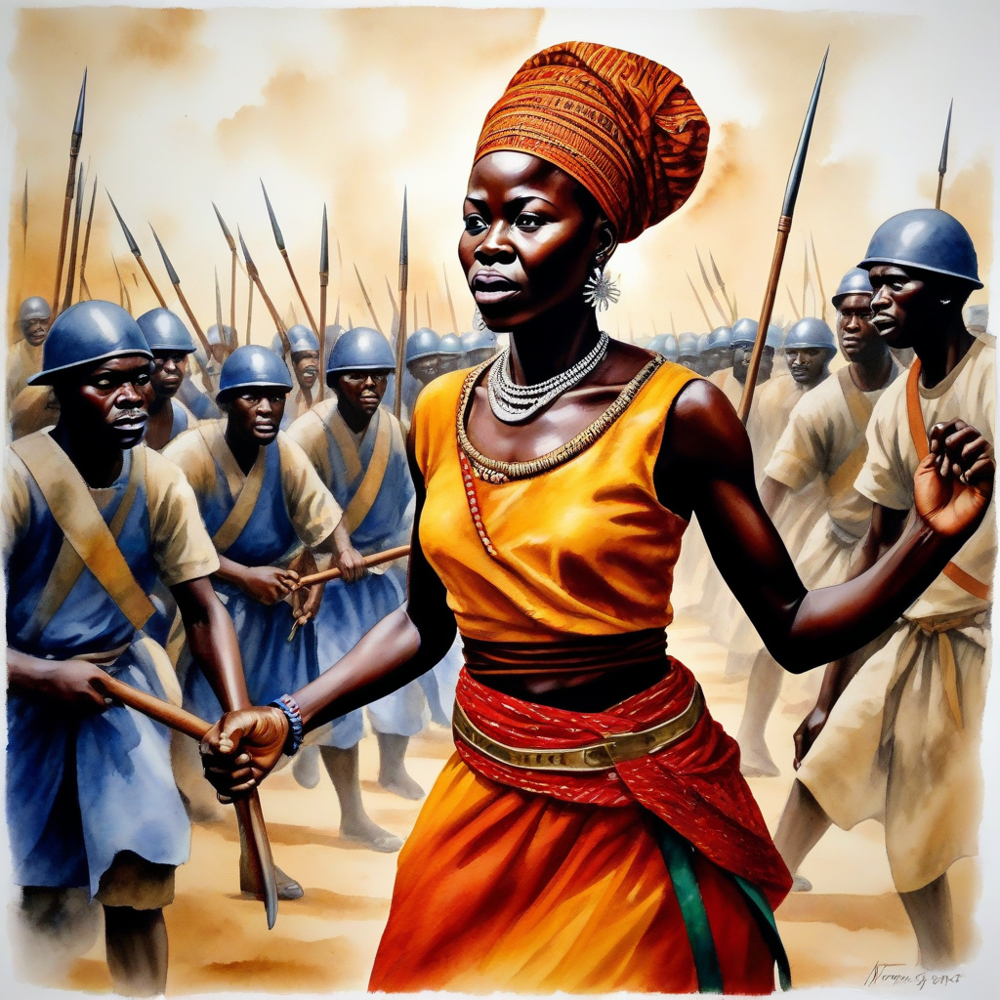
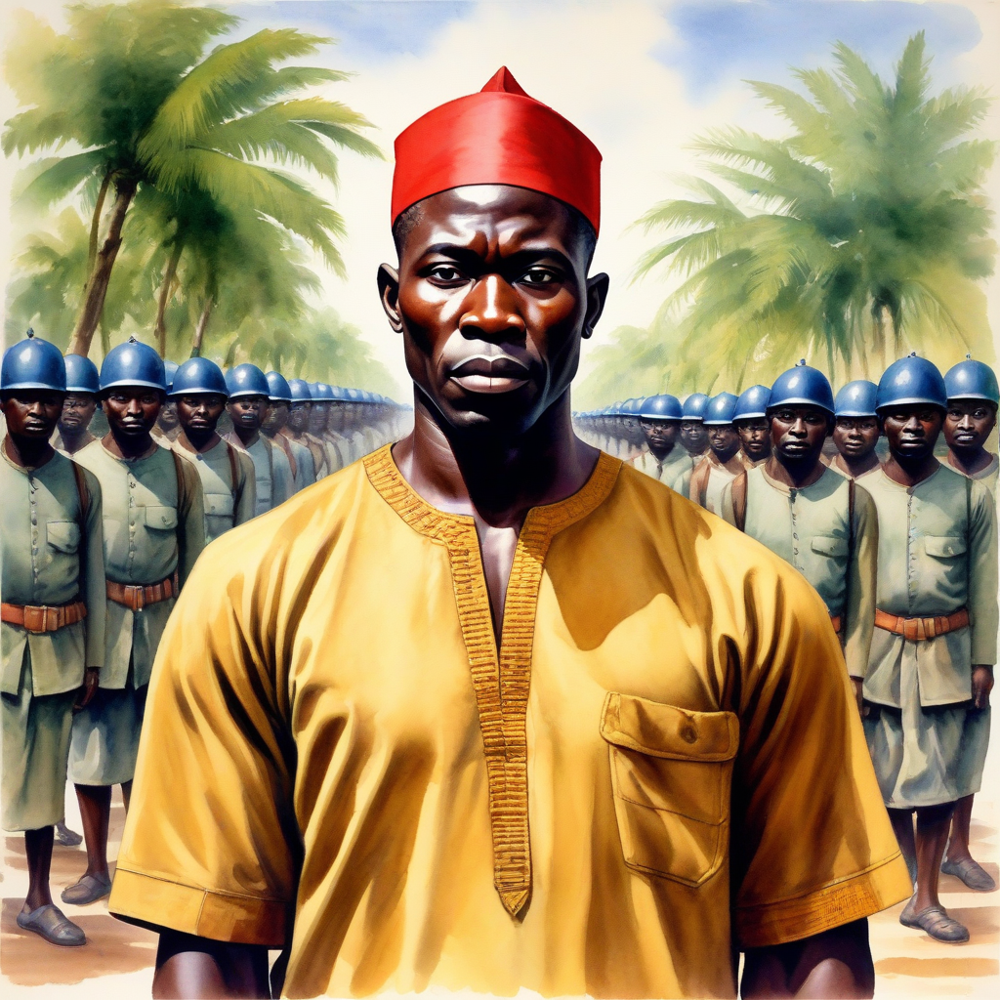
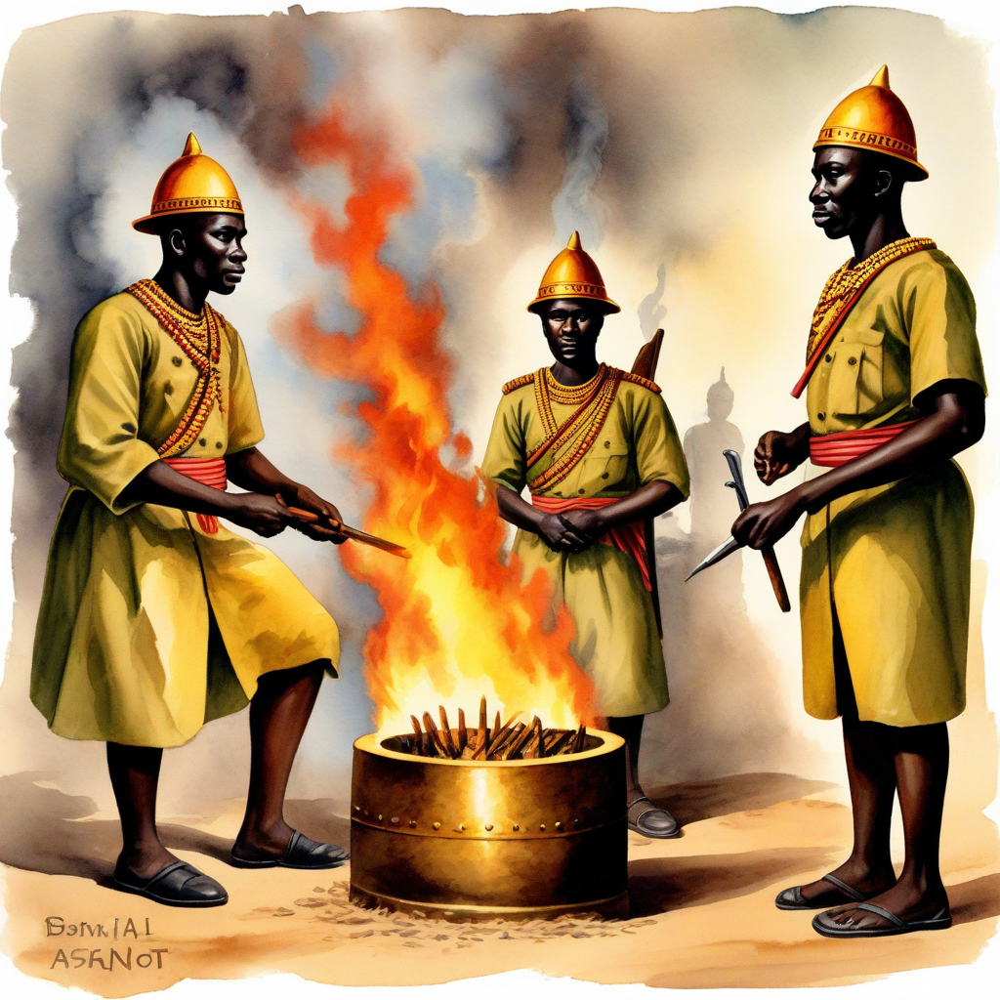

In [ ]:
media.show_images(images)

In [ ]:
len(all_images)

3

In [ ]:
prompt = response.scenes[3:]
prompt

['Nana Yaa Asantewaa, painting benin style, mugshot, is captured and exiled to the Seychelles.',
 'Prempeh I, painting benin style, mugshot, is also captured and exiled to the Seychelles.',
 'The Golden Stool, painting benin style, mugshot, is eventually returned to the Ashanti people, painting benin style, watercolor painting, a symbol of their resilience and strength.']

In [ ]:
prompt = response.scenes[:3]
prompt

['Nana Yaa Asantewaa, painting benin style, mugshot, leads her people in a fierce battle against the British soldiers, painting benin style, watercolor painting.',
 'Prempeh I, painting benin style, mugshot, stands defiantly before the British soldiers, watercolor painting.',
 'The British soldiers, watercolor painting, set fire to the Golden Stool, painting benin style, mugshot, a sacred symbol of the Ashanti people.']

In [ ]:
import random
prompt = response.scenes[3:]

for i in range(1):
  images = pipe(
    prompt=prompt,
    num_inference_steps = num_inference_steps,
    guidance_scale = 1.2,
    eta = eta,
    negative_prompt=negative_prompt,
    generator = torch.Generator(device).manual_seed(seed)).images
  all_images.extend(images)


  0%|          | 0/8 [00:00<?, ?it/s]

,,

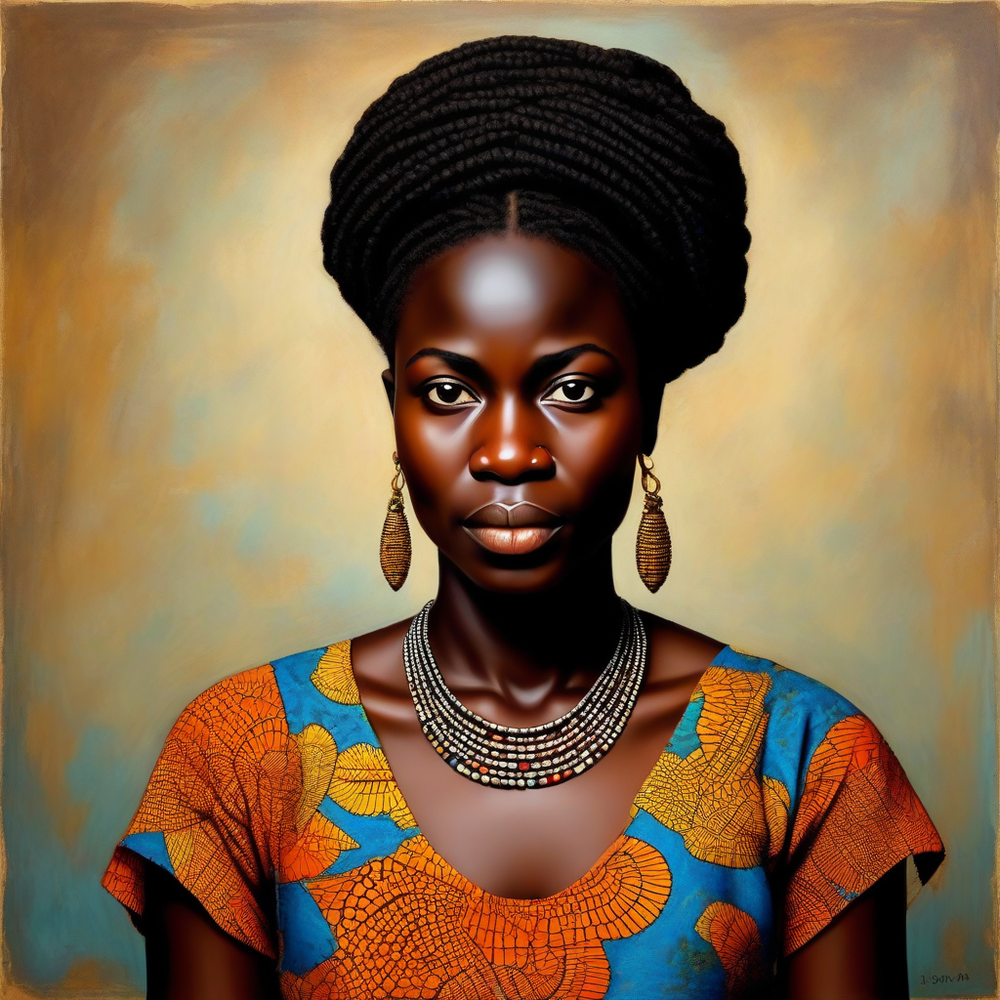
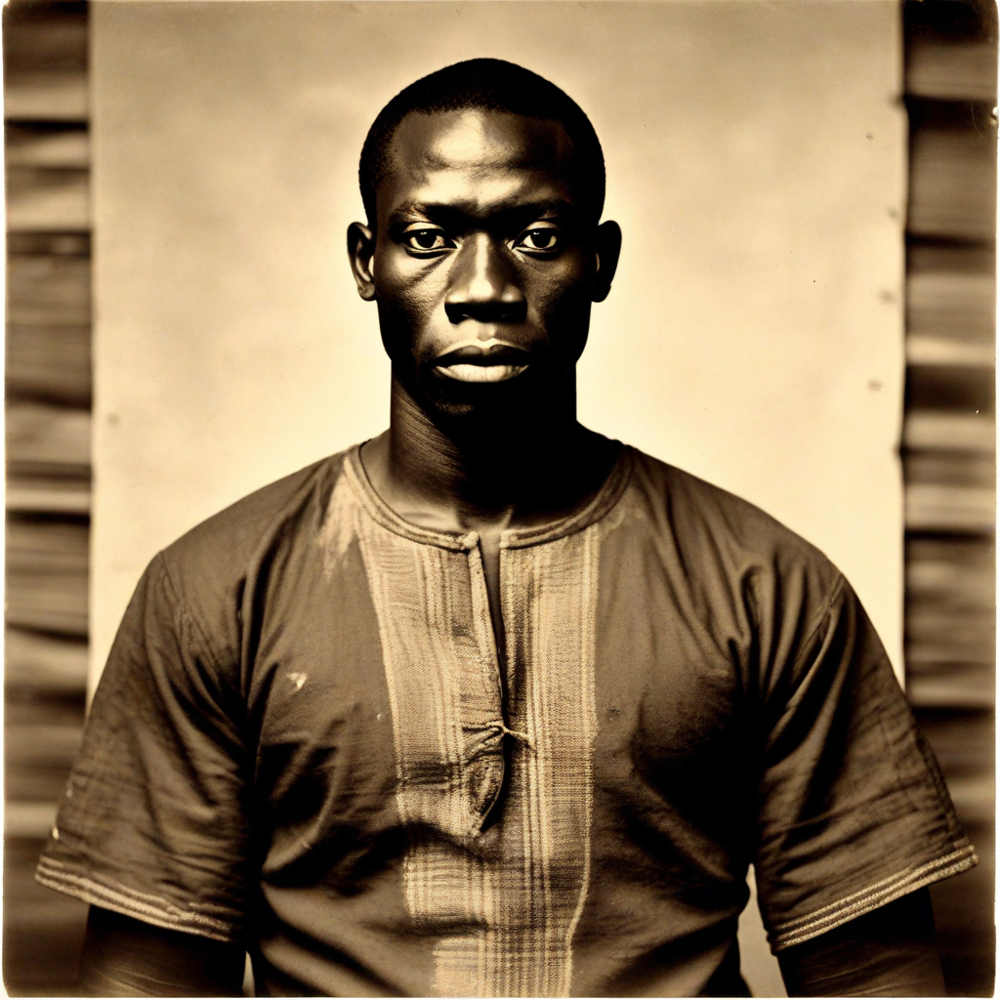
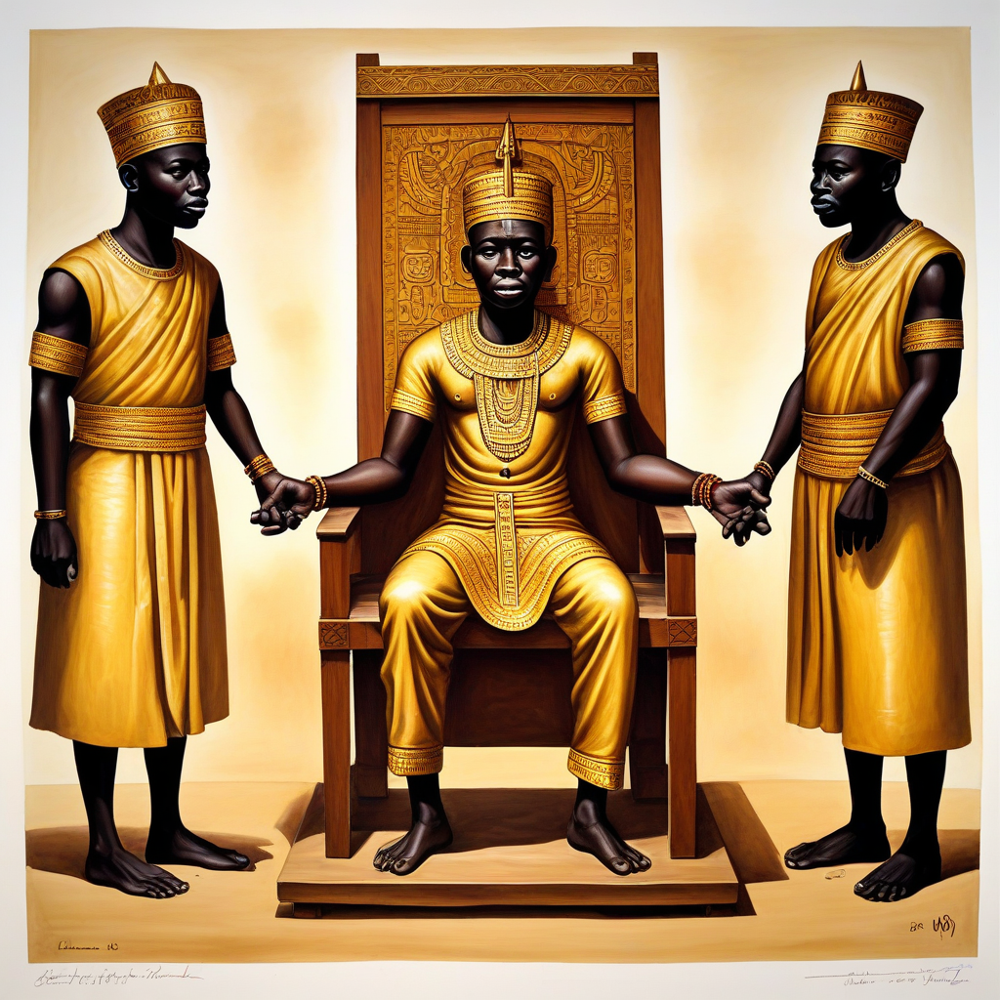

In [ ]:
media.show_images(images)

In [ ]:
all_images

[<PIL.Image.Image image mode=RGB size=1024x1024>,
 <PIL.Image.Image image mode=RGB size=1024x1024>,
 <PIL.Image.Image image mode=RGB size=1024x1024>,
 <PIL.Image.Image image mode=RGB size=1024x1024>,
 <PIL.Image.Image image mode=RGB size=1024x1024>,
 <PIL.Image.Image image mode=RGB size=1024x1024>]

In [ ]:
len(all_images)


6

In [ ]:
num_rows=3
num_cols=2

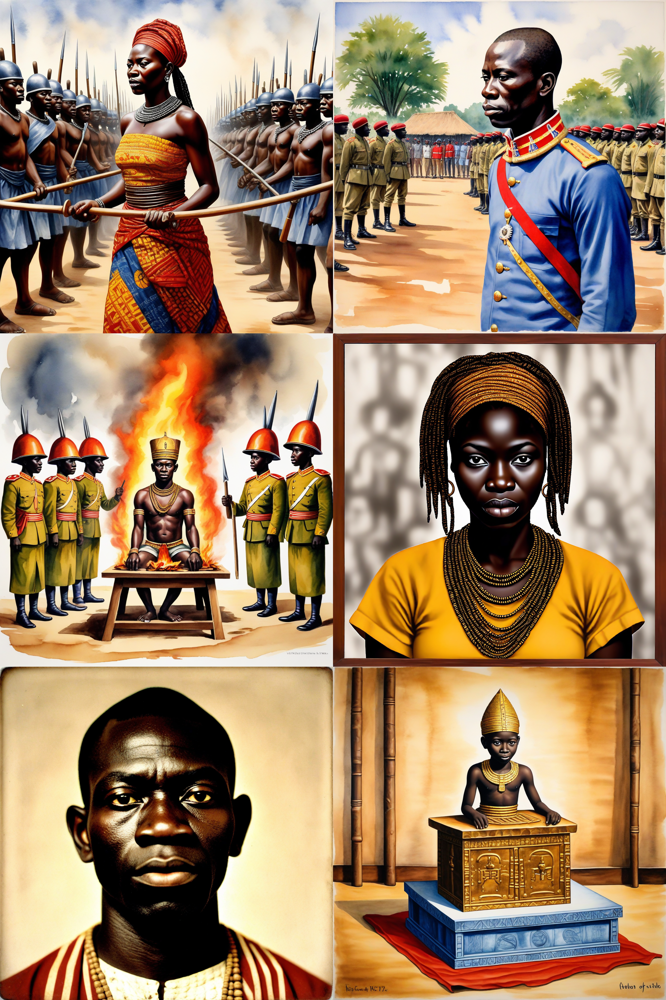

In [ ]:
grid = image_grid(all_images,rows=num_rows,cols=num_cols)
grid


In [ ]:
all_images.clear()

In [ ]:

output=remove(images[0])
# output.save()

100%|████████████████████████████████████████| 176M/176M [00:00<00:00, 137GB/s]


In [ ]:
# describe = ['bien','mal','cool','passable'] List to store image descriptions
describe=response.metadonne


In [ ]:
import requests
headers = {
	"content-type": "application/x-www-form-urlencoded",
	"Accept-Encoding": "application/gzip",
	"X-RapidAPI-Key": "93b44d51b3mshb932a1401b36390p1576acjsnc37a2971cd58",
	"X-RapidAPI-Host": "google-translate1.p.rapidapi.com"
}

def traduire(text,cible="yo"):
  url = "https://google-translate1.p.rapidapi.com/language/translate/v2"
  payload = {
	"q":text,
	"target":cible}
  output = requests.post(url, data=payload, headers=headers)
  out=output.json()
  yop=out['data']['translations'][0]['translatedText']
  return yop


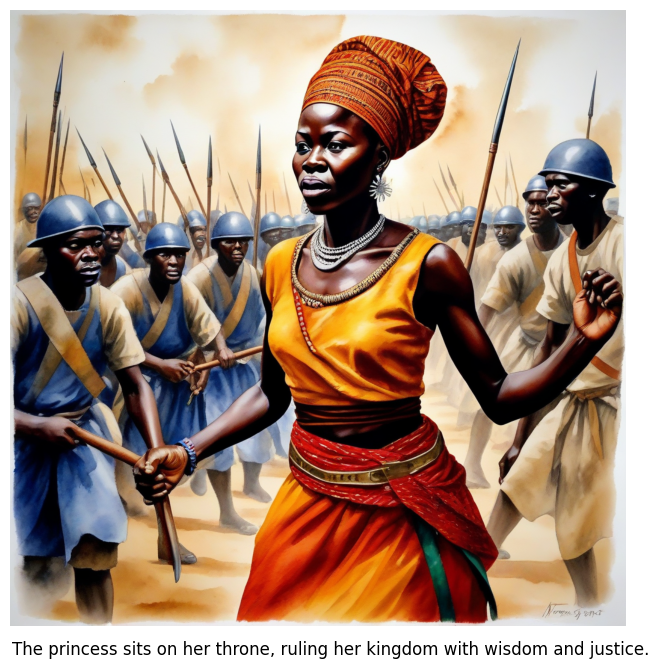

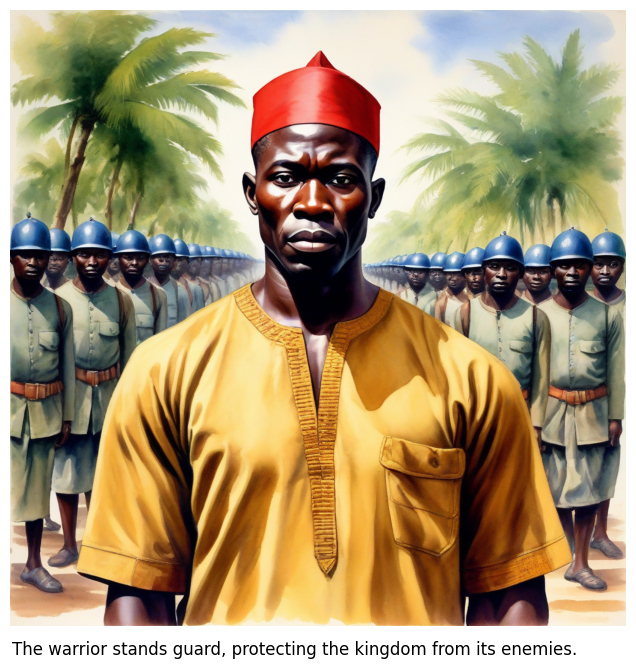

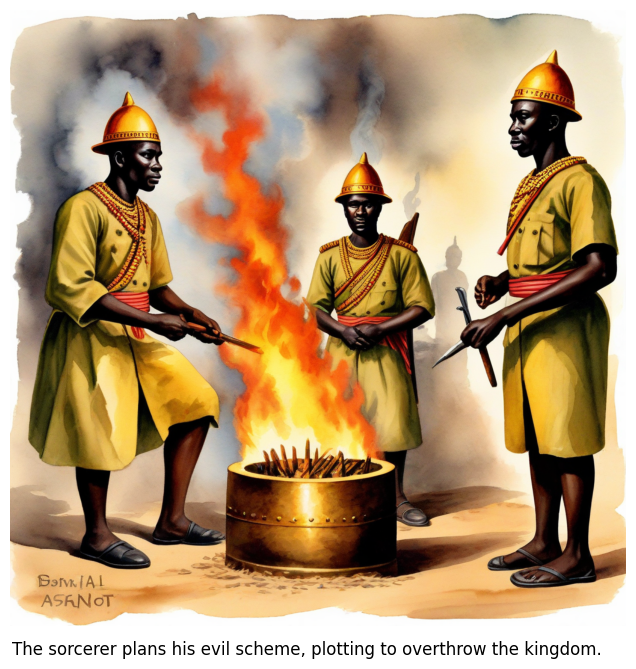

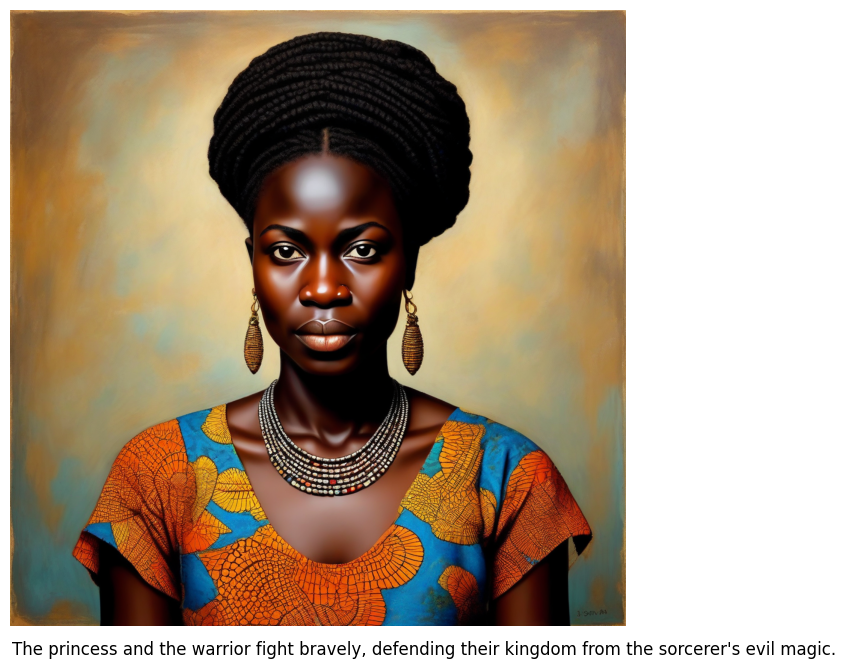

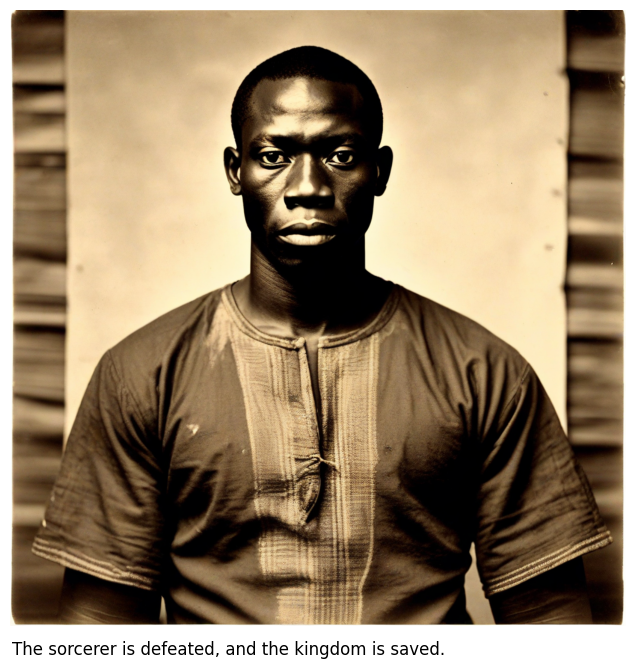

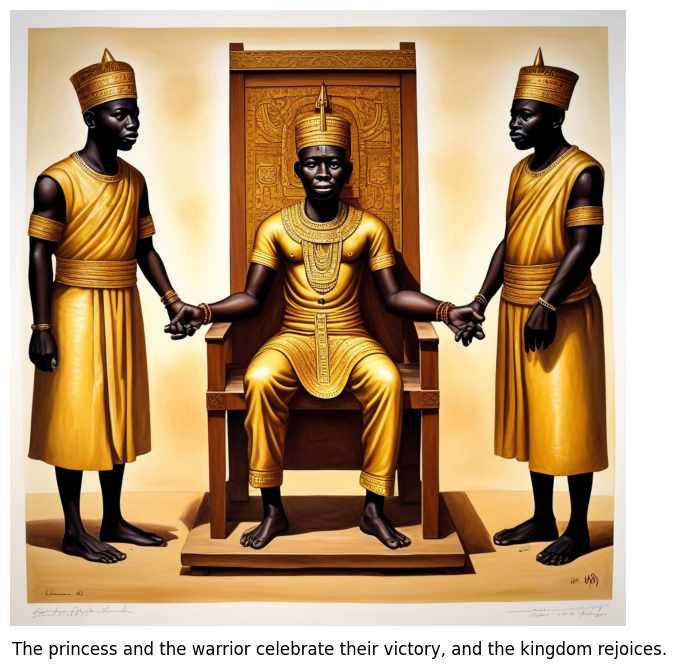

In [ ]:
# Function to display image with description as a legend
def display_image_with_description(image, description):
    fig, ax = plt.subplots(figsize=(8, 8))  # Create figure and axes
    ax.imshow(image)
    ax.axis('off')  # Turn off axes
    fig.text(0.13, 0.08, description, ha='left', va='center', fontsize=12)  # Add description as legend
    plt.show()

# Display each image with its description
for i in range(len(all_images)):
    display_image_with_description(all_images[i], describe[i])

### Mise en place du traducteur

In [ ]:
traduire("je suis malade","en")
traduire("je suis malade")

KeyError: 'data'

In [ ]:
#traduire une liste
liste_evenements = ["Hello", "How are you?", "Good morning"]
liste_traduite = [traduire(evenement) for evenement in liste_evenements]
liste_traduite

In [ ]:
output